Super Resolution & GAN
=
> # 목차
> ---
> ## 1. 목표 및 의의    
> ## 2. 이론 [go](#2-이론)    
>   > 1 [Interpolation](#1-intrepolation)    
>   > 2 [SRCNN & SRGAN](#2-srcnn-srgan)     
>   > 3 [Super Resolution 결과 평가하기](#3-super-resolution-결과-평가하기)     
> ## 3. 코드 분석 [go](#3-코드-분석)     
>   > [1 SRCNN 구현하기](#1-srcnn-구현하기)
>   > [2 SRGAN 구현하기](#2-srgan-구현하기)
>   > [4 Super Resolution 평가하기](#4-)     
> ## 4. 아쉬운 점 [go](#4-아쉬운-점)     


<br><br><br>

- - - -

# 1. 목표 및 의의     

## 1) 이미지 복원 원리에 대해 알아본다.    

## 2) 이미지 복원 모델을 재현해보고, 모델을 구현할 수 있다.     

<br><br><br>

- - - - 
# 2. 이론

## 1) Interpolation 
### 저해상도 이미지를 고해상도 이미지로 바꾸고 싶으며 어떻게 해야할까요? 한번 예를 들어보겠습니다. 30x40 사이즈의 이미지가 있습니다. 이 이미지를 300x400사이즈의 이미지로 업그레이드 하고 싶으면 어떻게 해야할까요? 일단 30x40사이즈 이미지의 픽셀과 픽셀 사이에 상하 좌우가 10배가 되도록 픽셀을 채워넣어야 할 것입니다. 그렇다면, 픽셀을 채워넣어서 어떠한 값을 할당해 주어야 할텐데, 어떤 값을 넣어주면 될까요? 이와같은 고민을 해결해주는 것으로 Interpolation(보간법)이라는 기술이 있습니다. Bilinear Interpolation(2차원 선형보간법), Bicubic Interpolation(2차원 삼차보간법), 등 다양한 보간법이 있으며, 각기 다른 방법으로 새로 추가한 픽셀들의 값을 결정해주게 됩니다.

### $\bullet$ Linear Interpolation(선형보간법)     
> ### 선형보간법에서는 현 문제가 단순히 이미 값이 존재하는 픽셀을 양 끝에 놓고, 그 사이의 데이터를 채우는 상황으로 묘사됩니다. 이 보강법은 이름 그대로 선형성을 따져서, 사전에 값이 존재하는 픽셀을 포함한 각 픽셀들이 등차의 관계를 유지하도록, 보강하게 됩니다. 1차적으로는 가장 자연스러운 방법이라고 생각할 수 있지만, 잘 생각해보면, 매끄러운 곡선이 있는 이미지에서는 선의 일부를 직선으로만 바꿔주는 문제가 있을 수 있습니다. 이것을 보강할 방법을 생각해보면 자연스럽게 삼차 보간법으로 흐름이 넘어가게 됩니다.    

### $\bullet$ Cubic Interpolation(삼차보간법)      
> ### 삼차보간법이 선형보간법과 다른 핵심적인 아이디어는 사전에 존재하는 픽셀을 양끝점으로 두고 그 점으로부터만 값을 계산하는 방법을 바꾸어, 양끝점 픽셀 바깥의 점까지 하나 추가하여 본다고 할 수 있습니다. 이렇게 보다 여러개의 점을 확인하여, 3차 함수를 유도하여 문제를 해결합니다. 보간된 픽셀들은 보다 많은 정보를 확인하고 결정해주었기 때문에, 보다 자연스러운 값을 예측할 수 있습니다.


하지만 이렇게 예측한 값들이 있다 하더라도, 당연히 실제 값을 그대로 맞출 수는 없습니다. 보다 자연스럽게 이미지를 고해상도로 만드려는 노력이 있습니다. 바로 딥러닝을 사용하여, 모델이 픽셀의 값을 맞추도록 하는 것입니다. 



## 2) SRCNN & SRGAN

### 아래와 같이 단순이 conv2d layer를 몇겹 쌓아서, 이미지를 보강할 수 있습니다.   

![이미지](data/e-22-9.srcnn.max-800x600.png)
### 보기에는 단순해보이지만, 이러한 시도로 딥러닝으로 이미지를 보강하려는 다양한 시도가 나타나게 됩니다. 그로써 저희가 오늘 다뤄볼 SRGAN이 탄생하게 됩니다.   

![간](data/e-22-14.srgan.max-800x600.png)

### 원리는 일반적인 GAN과 같습니다. CNN과 비교하여 우수한 점은, 이미지 보강에 원래 올바른 답변은 없다는 것입니다. SRCNN은 답을 보고 MSE를 통해 정답을 학습하여, 실제와 비슷한 보강을 하는 법을 배운다면, SRGAN에서는 실제 정답으로 학습을 할수는 없는 대신, 실제 같아보이는 이미지를 만들도록 학습할 수 있는 것입니다. 원래 정답이 없는 상황에 오히려 잘 맞는 학습법이라는 생각이 듭니다.

## 3) Super Resolution 결과 평가하기

### 이미지 보강의 결과를 평가하는데에는 많은 어려움이 따릅니다. 원본과 얼마나 비슷한지, 결국 사람의 마음에 들어야하기 때문입니다. 하지만 몇가지 정량적 기준을 가지고 있습니다.

- PSNR(Peak Signal-to-Noise Ratio)
단순히 이미지 픽셀의 최대값인 255를 MSE로 나눈 값에 상용로그를 취한 값입니다. 최대값이 동일하지 않은 상황에서는, MSE로 얼마나 잘 보강되었는지 비교하기가 적절치 않기때문에, 비율로서 비교한다고 생각하면 되겠습니다. 다만 MSE를 역수취한 값을 반영하기 때문에, 점수는 높을 수록 이미지 보강이 잘 되는 것입니다. dB(데시벨)단위를 사용합니다. 하지만 이것은 MSE가 낮도록 직접 학습시킨 SRCNN이 오히려 더 좋은 점수를 얻을 것입니다. 어떻게 이 문제를 해결할 수 있을까요?

- SSIM(Structural Similarity Index Map)
이미지 품질 평가(image quality assessment)에 가장 영향력있는 방법으로 지역적으로 이미지의 평균밝기, 표준편차, 구조 이상 세가지에 대한 원본이미지와의 비교값(1일수록 원본과 같음)을 각각 곱하여, SSI(Structural Similarity Index) 하나의 값을 얻는 방법입니다. 지역적으로 얻은 값이기 때문에, 전체 이미지에서 각각 부분에서 값을 얻어 나타나는 것이 SSIM(Structural Similarity Index Map)이며, 여기서 전체를 산술평균 한 값으로 score를 얻습니다. 1보다 작으며, 1에 가까울 수록 우수한 품질입니다.

### 이렇게  몇가지 방법을 들어볼 수 있는데, 한번 직접 어떠한 결과를 나타내는지 확인해보도록 합시다!

<br><br><br><br>

- - - -
# 3. 코드 분석


[목차](#super-resolution-gan)
- - - -


## 1) SRCNN 구현하기


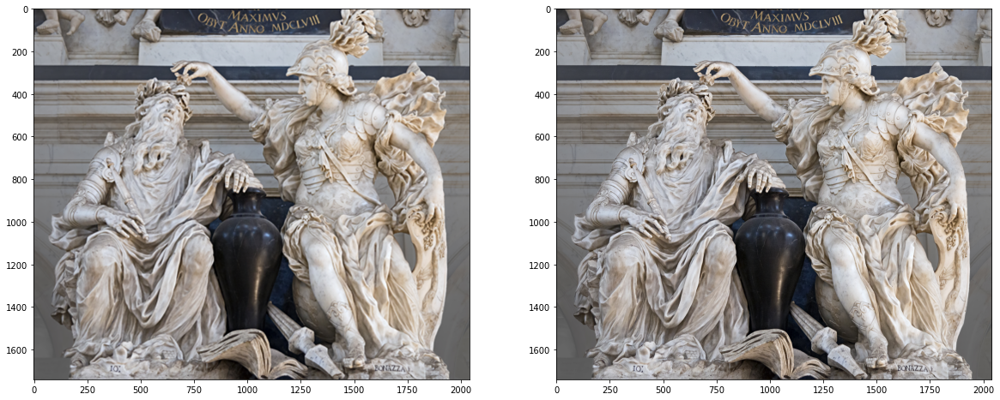

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

# 데이터를 불러옵니다.
train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

# 시각화를 위해 한 개의 데이터만 선택합니다.
for i, (lr, hr) in enumerate(valid):
    if i == 6: break 
    
# 저해상도 이미지를 고해상도 이미지 크기로 bicubic interpolation 합니다.  
hr, lr = np.array(hr), np.array(lr)
bicubic_hr = cv2.resize(
    lr, 
    dsize=(hr.shape[1], hr.shape[0]), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

# 저해상도 및 고해상도 이미지를 시각화합니다.
plt.figure(figsize=(20,10))
plt.subplot(1,2,1); plt.imshow(bicubic_hr)
plt.subplot(1,2,2); plt.imshow(hr)

Text(0.5, 1.0, 'HR')

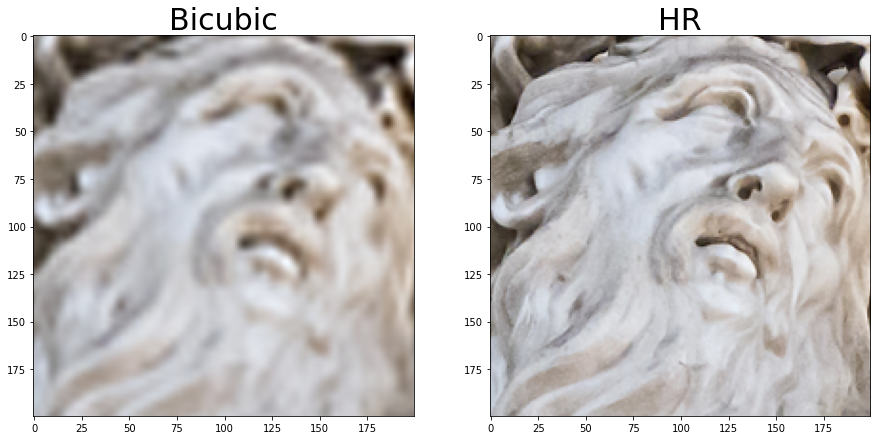

In [2]:
# 이미지의 특정 부분을 잘라내는 함수를 정의합니다.
def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

# interpolation된 이미지와 고해상도 이미지의 동일한 부분을 각각 잘라냅니다.
left_top = (400, 500)
crop_bicubic_hr = crop(bicubic_hr, left_top)
crop_hr = crop(hr, left_top)

# 잘라낸 부분을 시각화 합니다.
plt.figure(figsize=(15,25))
plt.subplot(1,2,1); plt.imshow(crop_bicubic_hr); plt.title("Bicubic", fontsize=30)
plt.subplot(1,2,2); plt.imshow(crop_hr); plt.title("HR", fontsize=30)

In [3]:
import tensorflow as tf

def preprocessing(lr, hr):
    # 이미지의 크기가 크므로 (96,96,3) 크기로 임의 영역을 잘라내어 사용합니다.
    hr = tf.image.random_crop(hr, size=[96, 96, 3])
    hr = tf.cast(hr, tf.float32) / 255.
    
    # 잘라낸 고해상도 이미지의 가로, 세로 픽셀 수를 1/4배로 줄였다가
    # interpolation을 이용해 다시 원래 크기로 되돌립니다.
    # 이렇게 만든 저해상도 이미지를 입력으로 사용합니다.
    lr = tf.image.resize(hr, [96//4, 96//4], "bicubic")
    lr = tf.image.resize(lr, [96, 96], "bicubic")
    return lr, hr

train = train.map(preprocessing).shuffle(buffer_size=10).batch(16)
valid = valid.map(preprocessing).batch(16)
print("✅")

✅


In [4]:
from tensorflow.keras import layers, Sequential

# 3개의 convolutional layer를 갖는 Sequential 모델을 구성합니다.
srcnn = Sequential()
# 9x9 크기의 필터를 128개 사용합니다.
srcnn.add(layers.Conv2D(128, 9, padding="same", input_shape=(None, None, 3)))
srcnn.add(layers.ReLU())
# 5x5 크기의 필터를 64개 사용합니다.
srcnn.add(layers.Conv2D(64, 5, padding="same"))
srcnn.add(layers.ReLU())
# 5x5 크기의 필터를 64개 사용합니다.
srcnn.add(layers.Conv2D(3, 5, padding="same"))

srcnn.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, None, None, 128)   31232     
_________________________________________________________________
re_lu (ReLU)                 (None, None, None, 128)   0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, None, None, 64)    204864    
_________________________________________________________________
re_lu_1 (ReLU)               (None, None, None, 64)    0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, None, None, 3)     4803      
Total params: 240,899
Trainable params: 240,899
Non-trainable params: 0
_________________________________________________________________


In [5]:
srcnn.compile(
    optimizer="adam", 
    loss="mse"
)

srcnn.fit(train, validation_data=valid, epochs=1)

50/50 [==============================] - 62s 937ms/step - loss: 0.0673 - val_loss: 0.0080


### 오늘은 잘 학습된 모델을 불러와서 성능을 확인해볼것입니다. 먼저 1epoch만 학습 한 후 결과입니다.

In [6]:
def apply_srcnn(image):
    sr = srcnn.predict(image[np.newaxis, ...]/255.)
    sr[sr > 1] = 1
    sr[sr < 0] = 0
    sr *= 255.
    return np.array(sr[0].astype(np.uint8))

srcnn_hr = apply_srcnn(bicubic_hr)

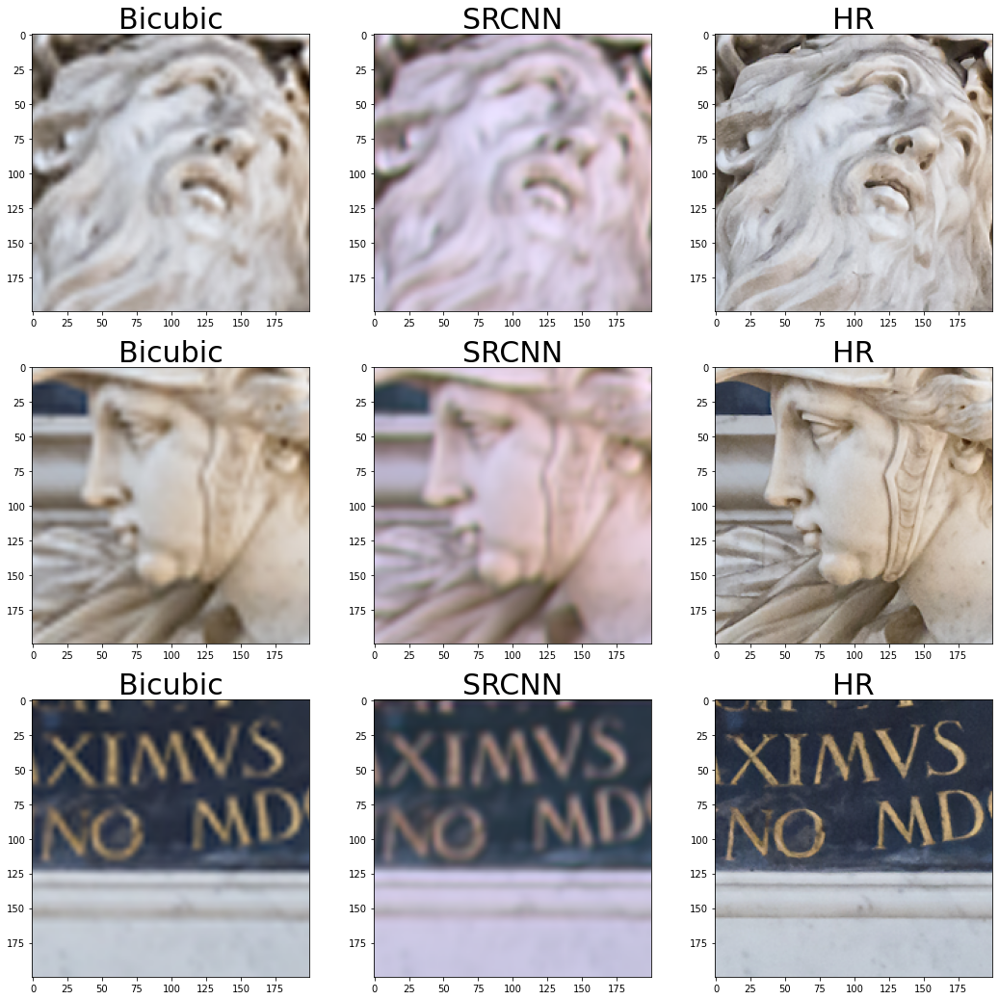

In [7]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,500), (300,1200), (0,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srcnn_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRCNN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

### 학습이 거의 되지 않았으니 어쩔 수 없는 결과군요. 이제 학습이 완료된 모델을 사용해보겠습니다.

In [8]:
import tensorflow as tf

model_file = 'data/srcnn.h5'
srcnn = tf.keras.models.load_model(model_file)

In [9]:
def apply_srcnn(image):
    sr = srcnn.predict(image[np.newaxis, ...]/255.)
    sr[sr > 1] = 1
    sr[sr < 0] = 0
    sr *= 255.
    return np.array(sr[0].astype(np.uint8))

srcnn_hr = apply_srcnn(bicubic_hr)

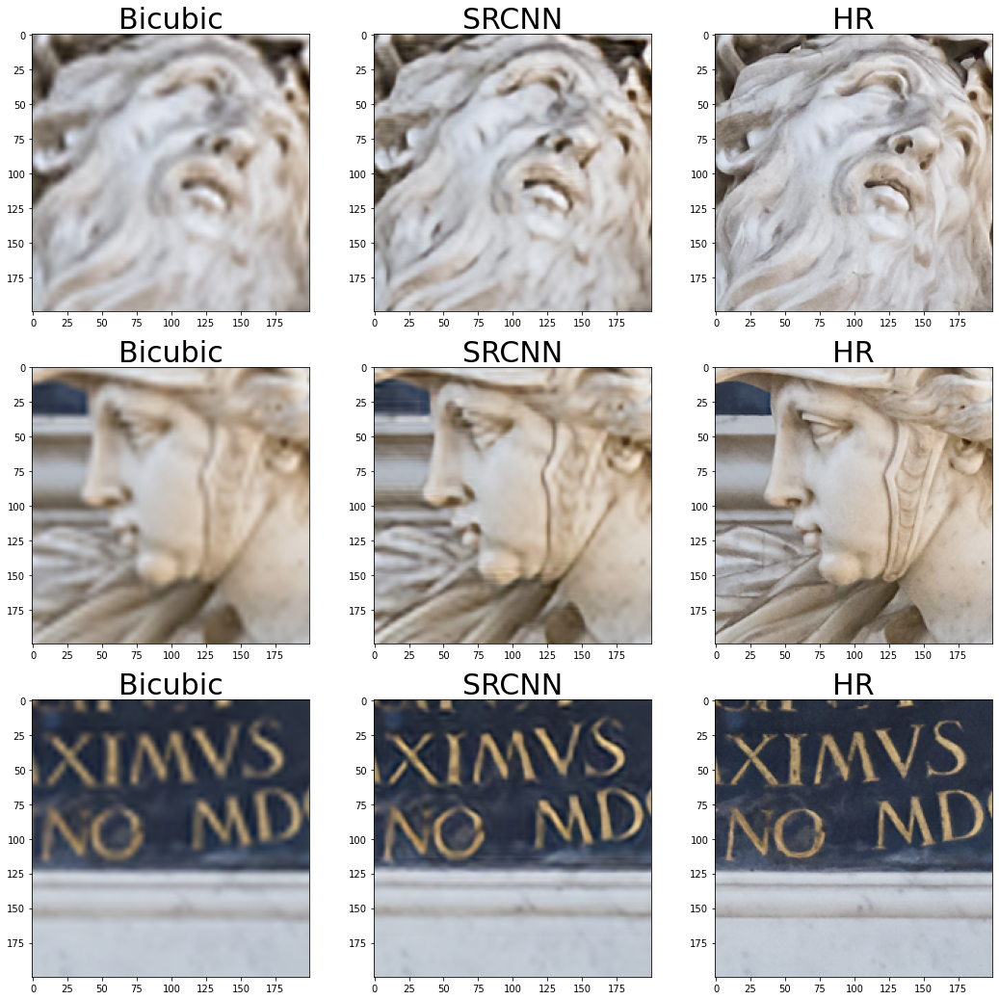

In [10]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,500), (300,1200), (0,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srcnn_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRCNN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

### 조금 나아진 모습이 있군요.
### 이렇게 Super Resolution 계의 혁신이였던, SRCNN을 시험해봤습니다. 
### 그러면 최신은 어떨까요? SRGAN을 알아보겠습니다.

## 2) SRGAN 구현하기

In [11]:
train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)
def preprocessing(lr, hr):
    hr = tf.cast(hr, tf.float32) /255.
        
    # 이미지의 크기가 크므로 (96,96,3) 크기로 임의 영역을 잘라내어 사용합니다.
    hr_patch = tf.image.random_crop(hr, size=[96,96,3])
        
    # 잘라낸 고해상도 이미지의 가로, 세로 픽셀 수를 1/4배로 줄입니다
    # 이렇게 만든 저해상도 이미지를 SRGAN의 입력으로 사용합니다.
    lr_patch = tf.image.resize(hr_patch, [96//4, 96//4], "bicubic")
    return lr_patch, hr_patch

train = train.map(preprocessing).shuffle(buffer_size=10).repeat().batch(8)
valid = valid.map(preprocessing).repeat().batch(8)
print("✅")

✅


In [12]:
from tensorflow.keras import Input, Model, layers

# 그림의 파란색 블록을 정의합니다.
def gene_base_block(x):
    out = layers.Conv2D(64, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.PReLU(shared_axes=[1,2])(out)
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.Add()([x, out])

# 그림의 뒤쪽 연두색 블록을 정의합니다.
def upsample_block(x):
    out = layers.Conv2D(256, 3, 1, "same")(x)
    # 그림의 PixelShuffler 라고 쓰여진 부분을 아래와 같이 구현합니다.
    out = layers.Lambda(lambda x: tf.nn.depth_to_space(x, 2))(out)
    return layers.PReLU(shared_axes=[1,2])(out)
    
# 전체 Generator를 정의합니다.
def get_generator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 9, 1, "same")(inputs)
    out = residual = layers.PReLU(shared_axes=[1,2])(out)
    
    for _ in range(5):
        out = gene_base_block(out)
    
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.Add()([residual, out])
    
    for _ in range(2):
        out = upsample_block(out)
        
    out = layers.Conv2D(3, 9, 1, "same", activation="tanh")(out)
    return Model(inputs, out)

print("✅")

✅


In [13]:
from tensorflow.python.keras import applications
def get_feature_extractor(input_shape=(None, None, 3)):
    vgg = applications.vgg19.VGG19(
        include_top=False, 
        weights="imagenet", 
        input_shape=input_shape
    )
    # 아래 vgg.layers[20]은 vgg 내의 마지막 convolutional layer 입니다.
    return Model(vgg.input, vgg.layers[20].output)

print("✅")

✅


In [14]:
# 그림의 파란색 블록을 정의합니다.
def disc_base_block(x, n_filters=128):
    out = layers.Conv2D(n_filters, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(n_filters, 3, 2, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.LeakyReLU()(out)

# 전체 Discriminator 정의합니다.
def get_discriminator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 3, 1, "same")(inputs)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(64, 3, 2, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    
    for n_filters in [128, 256, 512]:
        out = disc_base_block(out, n_filters)
    
    out = layers.Dense(1024)(out)
    out = layers.LeakyReLU()(out)
    out = layers.Dense(1, activation="sigmoid")(out)
    return Model(inputs, out)

print("✅")

✅


In [15]:
from tensorflow.keras import losses, metrics, optimizers

generator = get_generator()
discriminator = get_discriminator()
vgg = get_feature_extractor()

# 사용할 loss function 및 optimizer 를 정의합니다.
bce = losses.BinaryCrossentropy(from_logits=False)
mse = losses.MeanSquaredError()
gene_opt = optimizers.Adam()
disc_opt = optimizers.Adam()

def get_gene_loss(fake_out):
    return bce(tf.ones_like(fake_out), fake_out)

def get_disc_loss(real_out, fake_out):
    return bce(tf.ones_like(real_out), real_out) + bce(tf.zeros_like(fake_out), fake_out)


@tf.function
def get_content_loss(hr_real, hr_fake):
    hr_real = applications.vgg19.preprocess_input(hr_real)
    hr_fake = applications.vgg19.preprocess_input(hr_fake)
    
    hr_real_feature = vgg(hr_real) / 12.75
    hr_fake_feature = vgg(hr_fake) / 12.75
    return mse(hr_real_feature, hr_fake_feature)


@tf.function
def step(lr, hr_real):
    with tf.GradientTape() as gene_tape, tf.GradientTape() as disc_tape:
        hr_fake = generator(lr, training=True)
        
        real_out = discriminator(hr_real, training=True)
        fake_out = discriminator(hr_fake, training=True)
        
        perceptual_loss = get_content_loss(hr_real, hr_fake) + 1e-3 * get_gene_loss(fake_out)
        discriminator_loss = get_disc_loss(real_out, fake_out)
        
    gene_gradient = gene_tape.gradient(perceptual_loss, generator.trainable_variables)
    disc_gradient = disc_tape.gradient(discriminator_loss, discriminator.trainable_variables)
    
    gene_opt.apply_gradients(zip(gene_gradient, generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradient, discriminator.trainable_variables))
    return perceptual_loss, discriminator_loss


gene_losses = metrics.Mean()
disc_losses = metrics.Mean()

for epoch in range(1, 6):
    for i, (lr, hr) in enumerate(train):
        g_loss, d_loss = step(lr, hr)
        
        gene_losses.update_state(g_loss)
        disc_losses.update_state(d_loss)
        
        # 10회 반복마다 loss를 출력합니다.
        if (i+1) % 10 == 0:
            print(f"EPOCH[{epoch}] - STEP[{i+1}] \nGenerator_loss:{gene_losses.result():.4f} \nDiscriminator_loss:{disc_losses.result():.4f}", end="\n\n")
        
        if (i+1) == 200:
            break
            
    gene_losses.reset_states()
    disc_losses.reset_states()

80142336/80134624 [==============================] - 1s 0us/step
EPOCH[1] - STEP[10] 
Generator_loss:0.0011 
Discriminator_loss:1.5351

EPOCH[1] - STEP[20] 
Generator_loss:0.0016 
Discriminator_loss:0.9735

EPOCH[1] - STEP[30] 
Generator_loss:0.0021 
Discriminator_loss:0.7547

EPOCH[1] - STEP[40] 
Generator_loss:0.0024 
Discriminator_loss:0.5957

EPOCH[1] - STEP[50] 
Generator_loss:0.0029 
Discriminator_loss:0.5159

EPOCH[1] - STEP[60] 
Generator_loss:0.0033 
Discriminator_loss:0.4398

EPOCH[1] - STEP[70] 
Generator_loss:0.0037 
Discriminator_loss:0.3788

EPOCH[1] - STEP[80] 
Generator_loss:0.0041 
Discriminator_loss:0.3327

EPOCH[1] - STEP[90] 
Generator_loss:0.0043 
Discriminator_loss:0.2968

EPOCH[1] - STEP[100] 
Generator_loss:0.0045 
Discriminator_loss:0.2693

EPOCH[1] - STEP[110] 
Generator_loss:0.0047 
Discriminator_loss:0.2476

EPOCH[1] - STEP[120] 
Generator_loss:0.0050 
Discriminator_loss:0.2281

EPOCH[1] - STEP[130] 
Generator_loss:0.0052 
Discriminator_loss:0.2113

EPOCH[1]

### 한번 테스트 해보겠습니다!

In [16]:
import numpy as np

def apply_srgan_test(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = generator.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

for i, (lr, hr) in enumerate(valid):
    if i == 6: break

srgan_hr = apply_srgan_test(lr)
print("✅")


✅


In [17]:
print(srgan_hr)


[[[1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 0]
  ...
  [1 1 1]
  [1 1 0]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 ...

 [[1 1 1]
  [1 1 1]
  [1 1 0]
  ...
  [1 1 1]
  [1 1 0]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 0]
  ...
  [1 1 1]
  [1 1 0]
  [1 1 1]]]


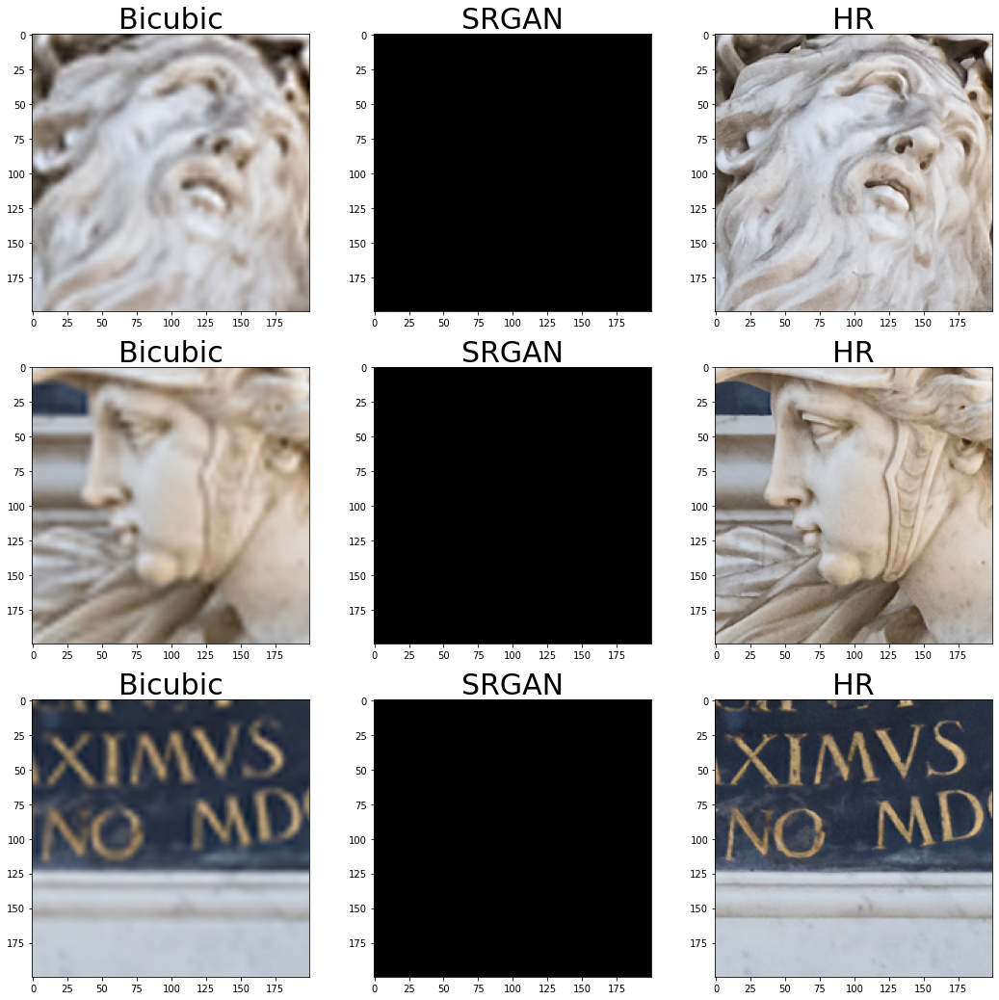

In [18]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,500), (300,1200), (0,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

### 뭐가 문제인 걸까요...!!

In [5]:
import tensorflow as tf
# import os

model_file = 'data/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [6]:
import numpy as np

def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

for i, (lr, hr) in enumerate(valid):
    if i == 6: break

srgan_hr = apply_srgan(lr)
print("✅")

NameError: name 'tfds' is not defined

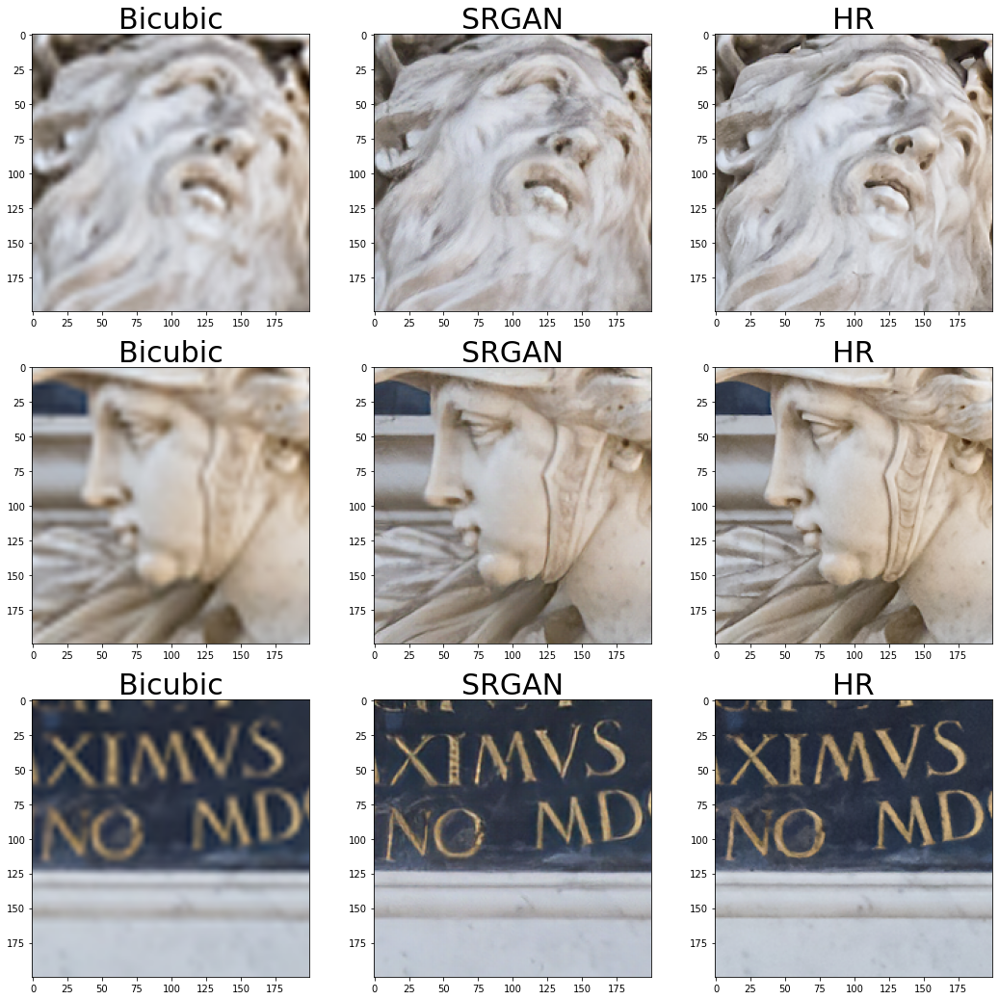

In [21]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,500), (300,1200), (0,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

(300, 451, 3)


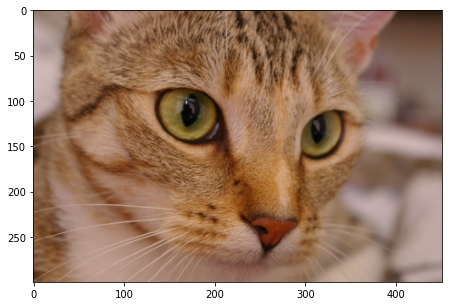

In [22]:
from skimage import data
import matplotlib.pyplot as plt

hr_cat = data.chelsea() # skimage에서 제공하는 예제 이미지를 불러옵니다.
hr_shape = hr_cat.shape[:2]

print(hr_cat.shape) # 이미지의 크기를 출력합니다.

plt.figure(figsize=(8,5))
plt.imshow(hr_cat)

In [23]:
from skimage.metrics import peak_signal_noise_ratio, structural_similarity

print("**동일 이미지 비교**")
print("PSNR :", peak_signal_noise_ratio(hr_cat, hr_cat))
print("SSIM :", structural_similarity(hr_cat, hr_cat, multichannel=True))

**동일 이미지 비교**
PSNR : inf
SSIM : 1.0


/opt/conda/lib/python3.7/site-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


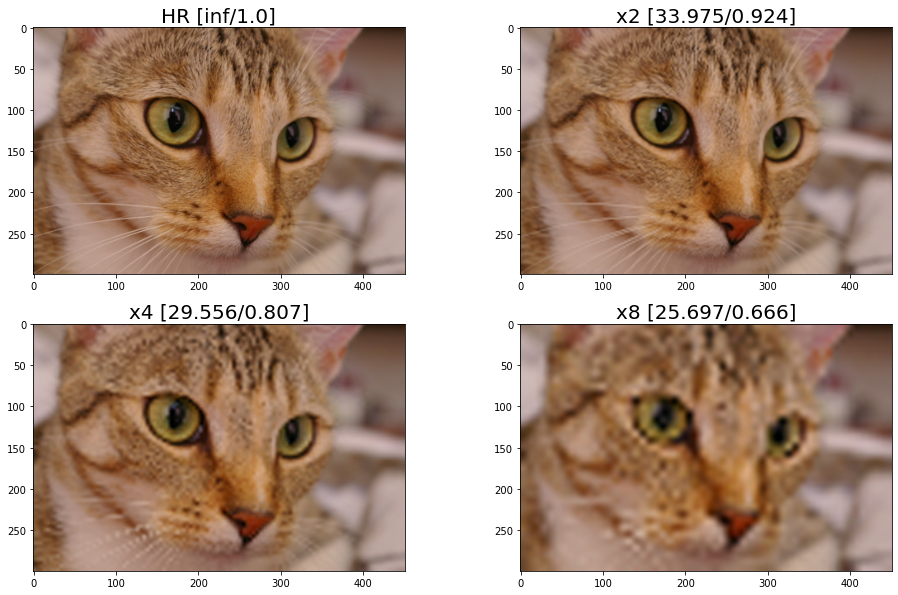

In [25]:
import cv2

# 이미지를 특정 크기로 줄이고 다시 늘리는 과정을 함수로 정의합니다.
def interpolation_xn(image, n):
    downsample = cv2.resize(
        image,
        dsize=(hr_shape[1]//n, hr_shape[0]//n)
    )
    upsample = cv2.resize(
        downsample,
        dsize=(hr_shape[1], hr_shape[0]),
        interpolation=cv2.INTER_CUBIC
    )
    return upsample

lr2_cat = interpolation_xn(hr_cat, 2) # 1/2로 줄이고 다시 복원
lr4_cat = interpolation_xn(hr_cat, 4) # 1/4로 줄이고 다시 복원
lr8_cat = interpolation_xn(hr_cat, 8) # 1/8로 줄이고 다시 복원

images = [hr_cat, lr2_cat, lr4_cat, lr8_cat]
titles = ["HR", "x2", "x4", "x8"]

# 각 이미지에 대해 PSNR을 계산하고 반올림합니다.
psnr = [round(peak_signal_noise_ratio(hr_cat, i), 3) for i in images]
# 각 이미지에 대해 SSIM을 계산하고 반올림합니다.
ssim = [round(structural_similarity(hr_cat, i, multichannel=True), 3) for i in images]

# 이미지 제목에 PSNR과 SSIM을 포함하여 시각화 합니다. 
plt.figure(figsize=(16,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=20)

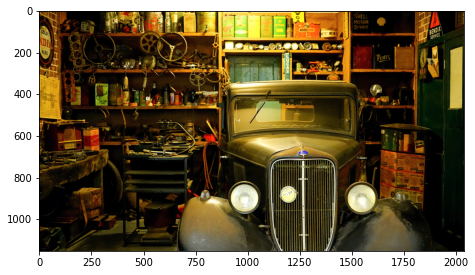

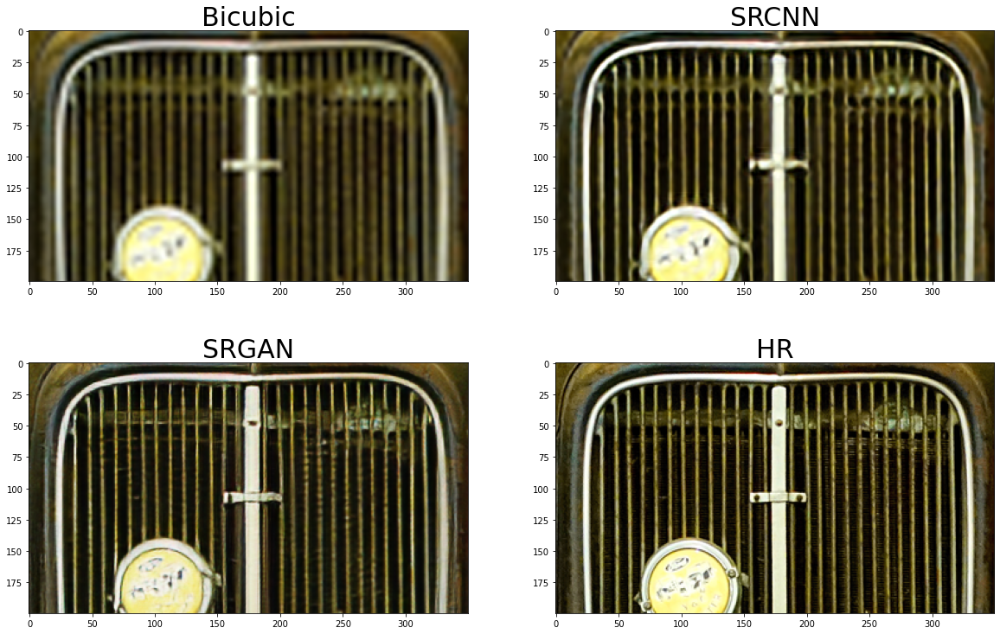

In [24]:
for i, (lr, hr) in enumerate(valid):
    if i == 12: break # 12번째 이미지를 불러옵니다.

lr_img, hr_img = np.array(lr), np.array(hr)

# bicubic interpolation
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

# 전체 이미지를 시각화합니다.
plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

# SRCNN을 이용해 고해상도로 변환합니다.
srcnn_img = apply_srcnn(bicubic_img)

# SRGAN을 이용해 고해상도로 변환합니다.
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (700, 1090) # 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.

# bicubic, SRCNN, SRGAN 을 적용한 이미지와 원래의 고해상도 이미지를 시각화합니다.
plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

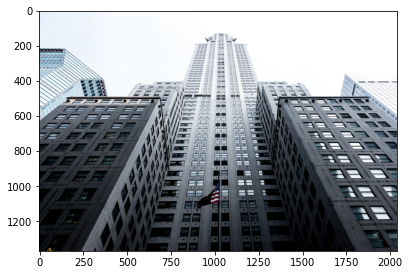

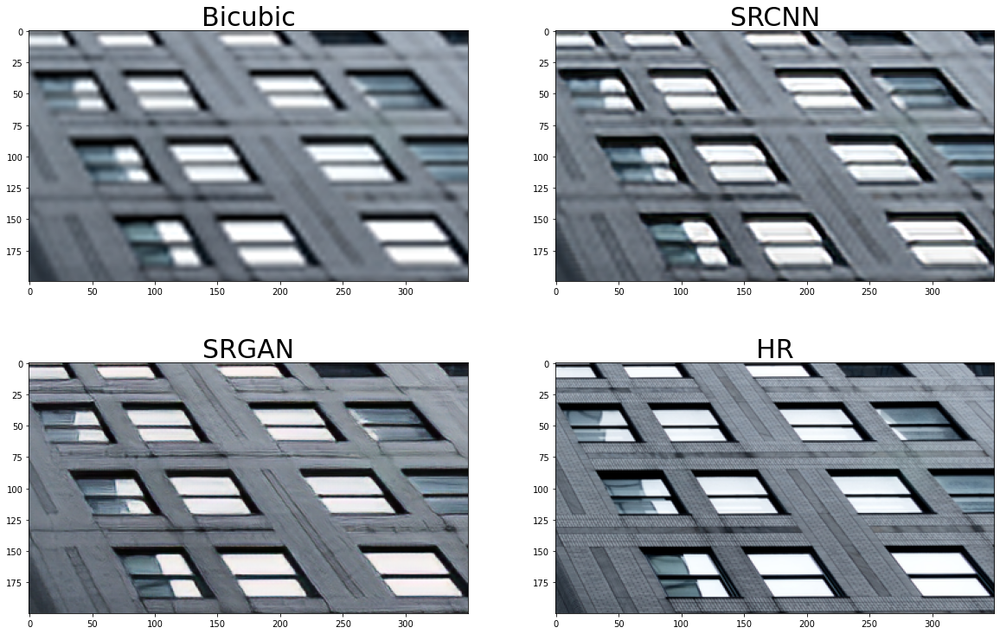

In [26]:
for i, (lr, hr) in enumerate(valid):
    if i == 15: break

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (600, 1500)

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

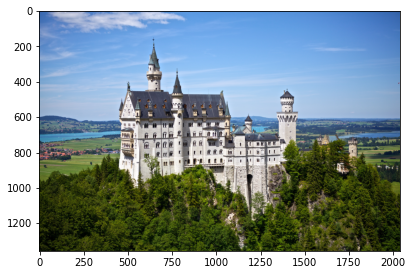

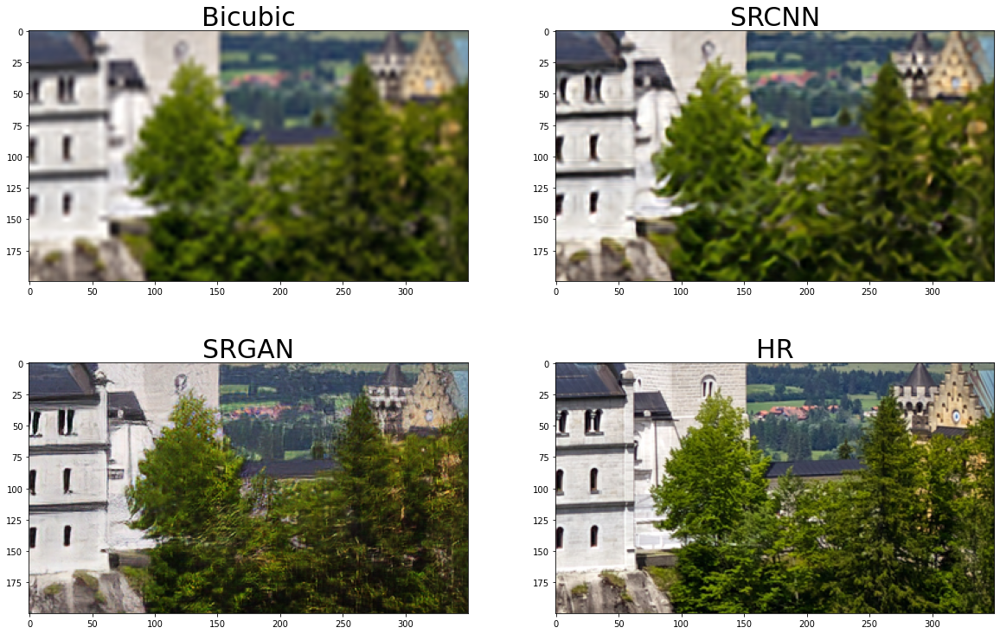

In [27]:
for i, (lr, hr) in enumerate(valid):
    if i == 24: break

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (700, 1300)

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

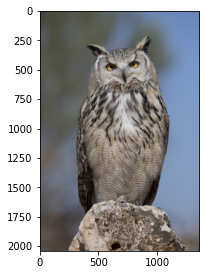

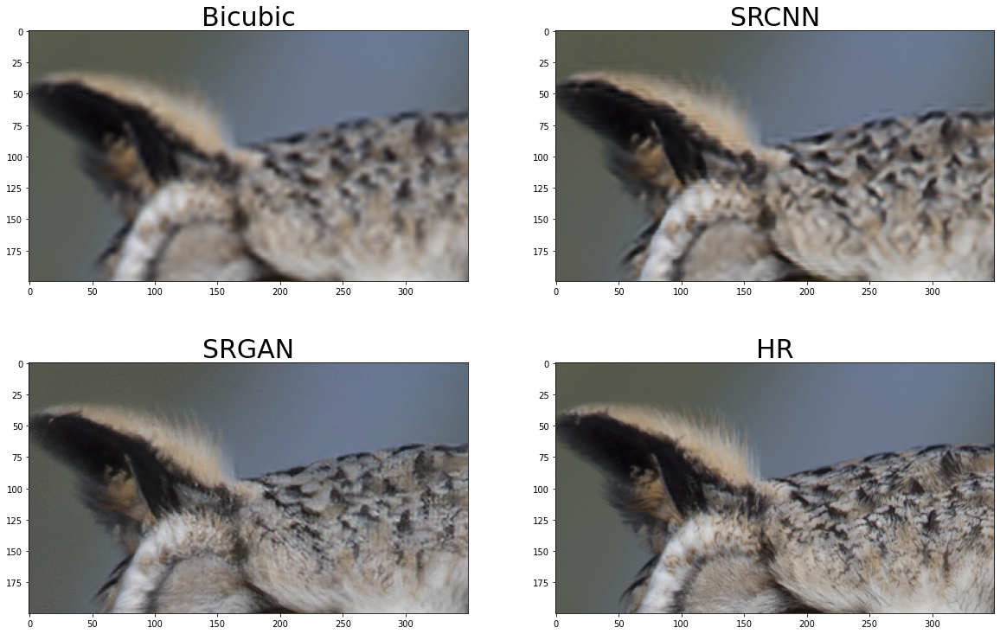

In [29]:
for i, (lr, hr) in enumerate(valid):
    # 불러올 이미지의 인덱스를 지정합니다.
    # 위에서 시각화 했던 8, 12, 15, 24 번을 제외한 다른 숫자를 넣어봅시다 
    if i == 36: break          

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

# 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.
left_top = (250,400)

plt.figure(figsize=(20,20)) # 이미지 크기를 조절할 수 있습니다.
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    # crop 함수 내의 세번째 네번째 인자를 수정해 이미지 크기를 조절합니다.
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

## 3) Super Resolution 평가하기
### 앞서 말했듯이, 뚜렷한 정답이 없는 Super Resolution은 얼마나 잘 된것인지 정량적 판단이 쉽지 않습니다.
### PSNR과 SSIM을 이용해서 평가해보도록 하겠습니다.

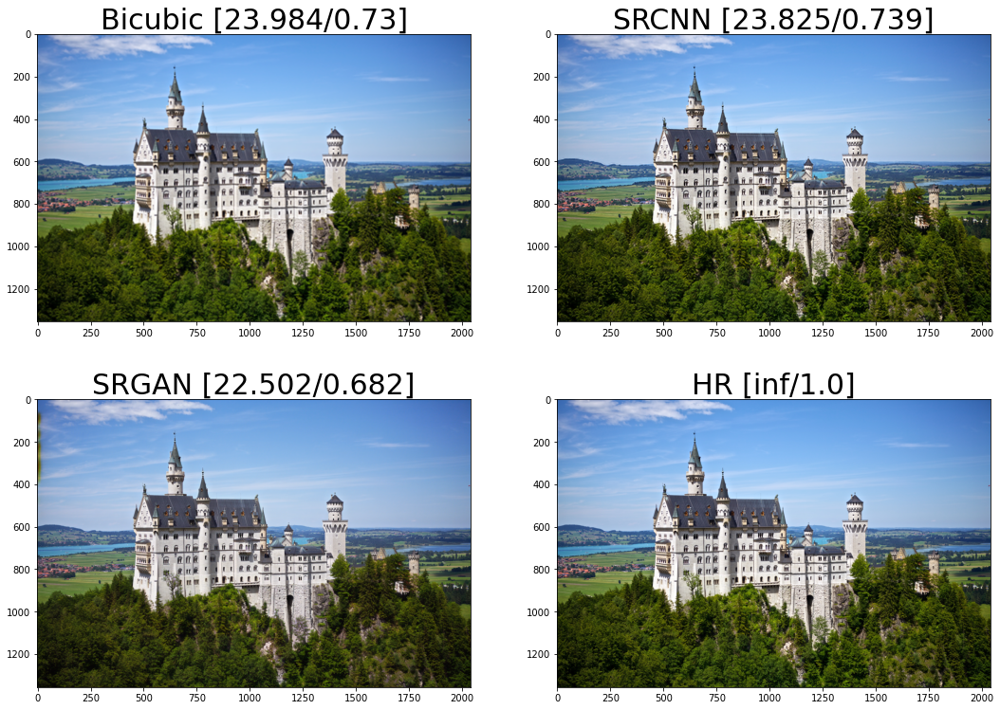

In [30]:
for i, (lr, hr) in enumerate(valid):
    if i == 24: break
    
lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img,
    (hr.shape[1], hr.shape[0]),
    interpolation=cv2.INTER_CUBIC
)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

# 각 이미지에 대해 PSNR을 계산하고 반올림합니다.
psnr = [round(peak_signal_noise_ratio(hr_img, i), 3) for i in images]
# 각 이미지에 대해 SSIM을 계산하고 반올림합니다.
ssim = [round(structural_similarity(hr_img, i, multichannel=True), 3) for i in images]

# 이미지 제목에 PSNR과 SSIM을 포함하여 시각화 합니다. 
plt.figure(figsize=(18,13))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

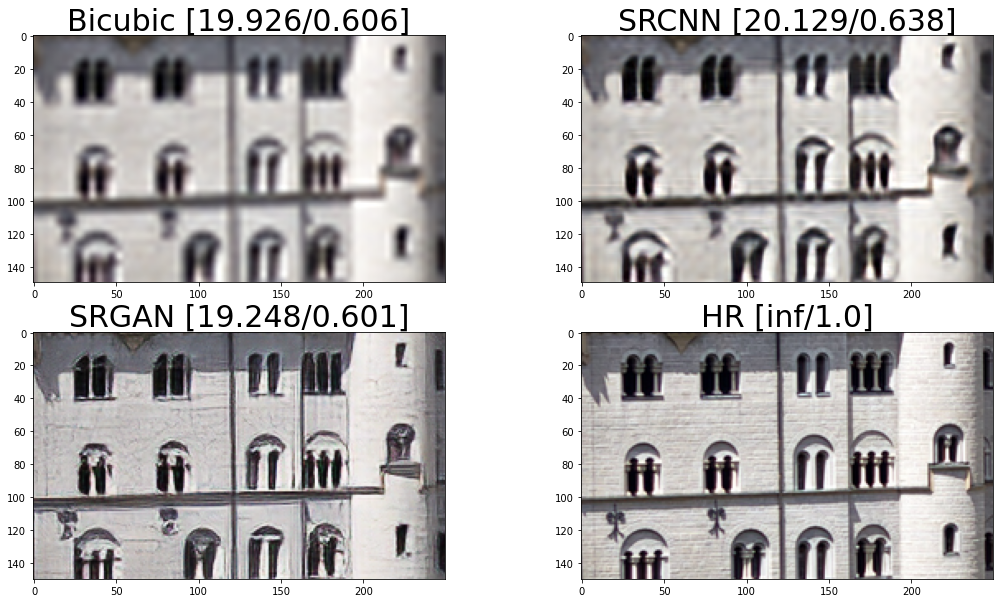

In [31]:
left_top = (620, 570)
crop_images = [crop(i, left_top, 150, 250) for i in images]

psnr = [round(peak_signal_noise_ratio(crop_images[-1], i), 3) for i in crop_images]
ssim = [round(structural_similarity(crop_images[-1], i, multichannel=True), 3) for i in crop_images]

plt.figure(figsize=(18,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

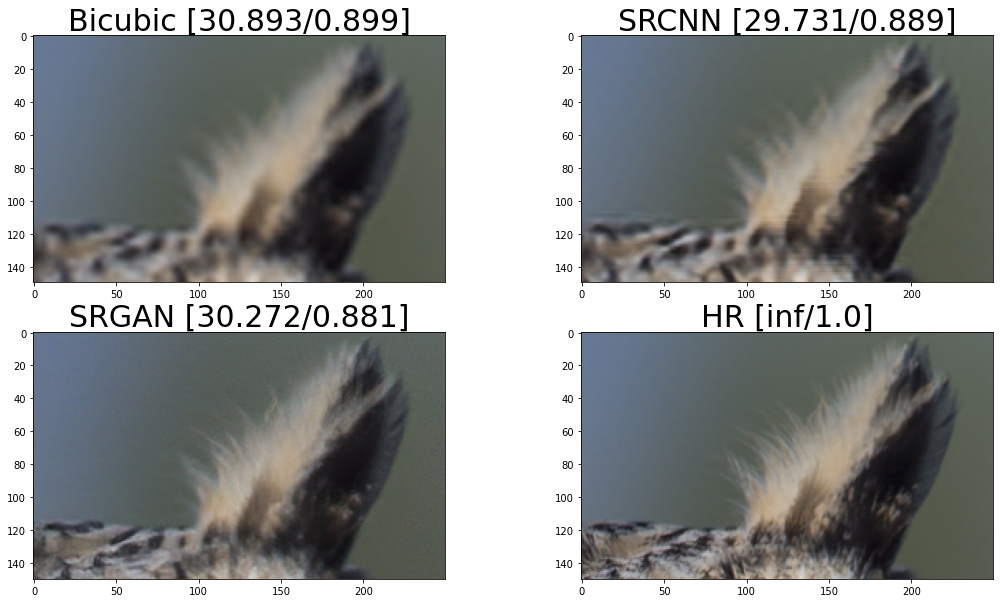

In [38]:
for i, (lr, hr) in enumerate(valid):
    # 불러올 이미지의 인덱스를 지정합니다.
    # 위에서 시각화 했던 8, 12, 15, 24 번을 제외한 다른 숫자를 넣어봅시다 
    if i == 36 : 
        break          

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img,
    (hr.shape[1], hr.shape[0]),
    interpolation=cv2.INTER_CUBIC
)

# 확대할 부분의 왼쪽 상단 좌표를 지정합니다.
left_top = (200,715) 

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]

# crop 함수 내의 세번째 네번째 인자를 수정해 이미지 크기를 조절합니다.
crop_images = [crop(i, left_top, 150, 250) for i in images] 
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

psnr = [round(peak_signal_noise_ratio(crop_images[-1], i), 3) for i in crop_images]
ssim = [round(structural_similarity(crop_images[-1], i, multichannel=True), 3) for i in crop_images]

plt.figure(figsize=(18,10)) # 이미지 크기를 조절할 수 있습니다.
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

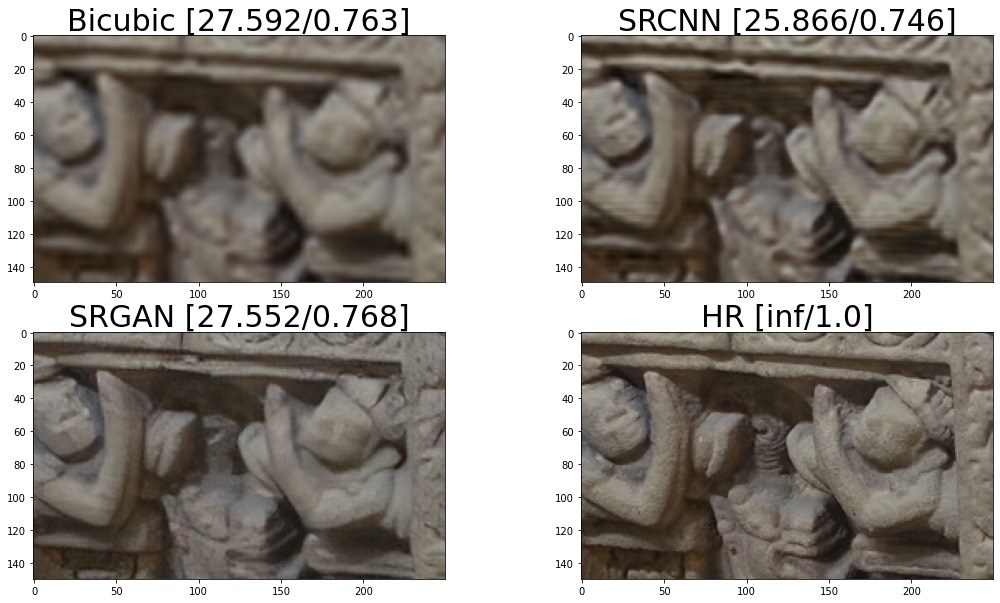

In [41]:
for i, (lr, hr) in enumerate(valid):
    # 불러올 이미지의 인덱스를 지정합니다.
    # 위에서 시각화 했던 8, 12, 15, 24 번을 제외한 다른 숫자를 넣어봅시다 
    if i == 16 : 
        break          

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img,
    (hr.shape[1], hr.shape[0]),
    interpolation=cv2.INTER_CUBIC
)

# 확대할 부분의 왼쪽 상단 좌표를 지정합니다.
left_top = (500,500) 

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]

# crop 함수 내의 세번째 네번째 인자를 수정해 이미지 크기를 조절합니다.
crop_images = [crop(i, left_top, 150, 250) for i in images] 
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

psnr = [round(peak_signal_noise_ratio(crop_images[-1], i), 3) for i in crop_images]
ssim = [round(structural_similarity(crop_images[-1], i, multichannel=True), 3) for i in crop_images]

plt.figure(figsize=(18,10)) # 이미지 크기를 조절할 수 있습니다.
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

### 이렇게 까지 하고 보니, PSNR과 SSIM라는 지표는 그저 원본에서 얼마나 이미지가 손상되었는지를 알아보는 지표라는 것이 느껴집니다. 특히 SRGAN은 원본과 같게 해주려는 노력보다는 이미지를 진짜 처럼 보이게 해주는 모델이기 때문에, 더 좋은 이미지를 만들고도

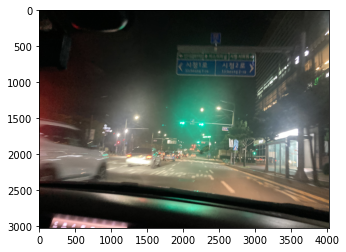

In [47]:
import cv2 as cv

front_view = cv.imread("data/lr.jpg")
plt.imshow(cv.cvtColor(front_view, cv.COLOR_BGR2RGB))

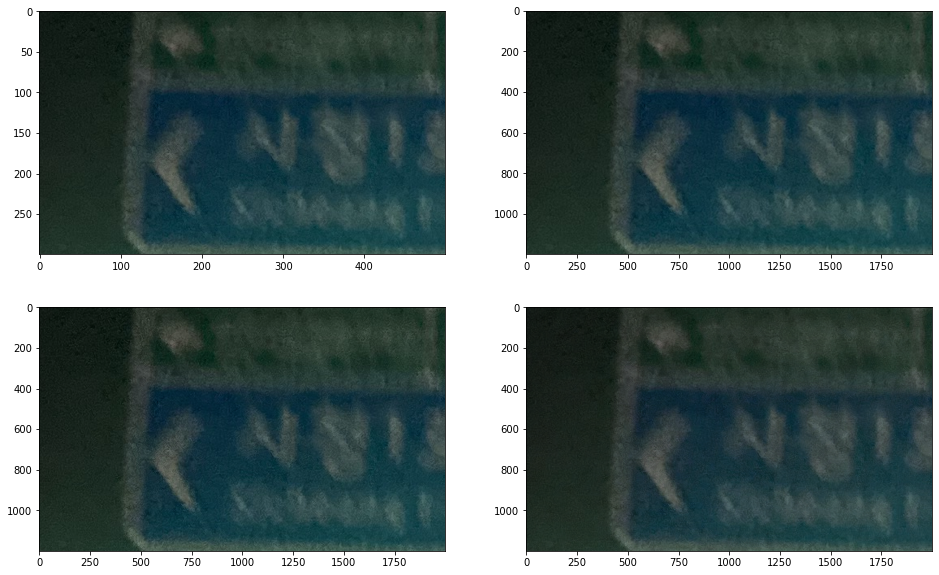

In [60]:
front_view_RGB = cv.cvtColor(front_view,cv.COLOR_BGR2RGB)[600:900,1800:2300]
bicubic = cv.resize(front_view_RGB,
                    (2000,1200),
                    interpolation=cv.INTER_CUBIC)
srcnn_do = apply_srcnn(bicubic)
srgan_do = apply_srgan(front_view_RGB)
plt.figure(figsize = (16,10))
plt.subplot(2,2,1)
plt.imshow(front_view_RGB)
plt.subplot(2,2,2)
plt.imshow(bicubic)
plt.subplot(2,2,3)
plt.imshow(srcnn_do)
plt.subplot(2,2,4)
plt.imshow(srgan_do)
plt.show()

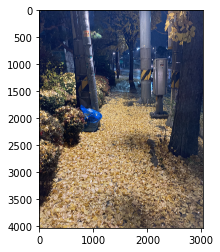

In [63]:
leaves = cv.imread("data/test.png")
plt.imshow(cv.cvtColor(leaves, cv.COLOR_BGR2RGB))

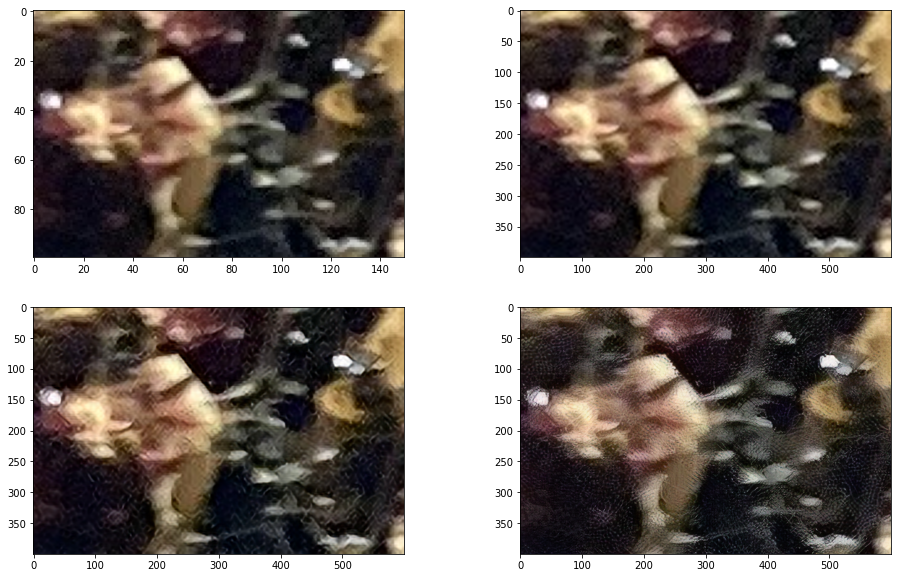

In [65]:
leaves_RGB = cv.cvtColor(leaves,cv.COLOR_BGR2RGB)[2000:2100,500:650]
bicubic = cv.resize(leaves_RGB,
                    (600,400),
                    interpolation=cv.INTER_CUBIC)
srcnn_do = apply_srcnn(bicubic)
srgan_do = apply_srgan(leaves_RGB)
plt.figure(figsize = (16,10))
plt.subplot(2,2,1)
plt.imshow(leaves_RGB)
plt.subplot(2,2,2)
plt.imshow(bicubic)
plt.subplot(2,2,3)
plt.imshow(srcnn_do)
plt.subplot(2,2,4)
plt.imshow(srgan_do)
plt.show()

### 문제가 무엇인지 조금 알 것 같습니다.
### 바로... 이미지가 깨끗하지 않은 것 뿐 이미 고화질이며 깨져있는 것입니다. 
### 이를 해결하기 위해, 이미지 크기를 줄인 후 모델에 집어넣는 방법을 사용해보겠습니다.

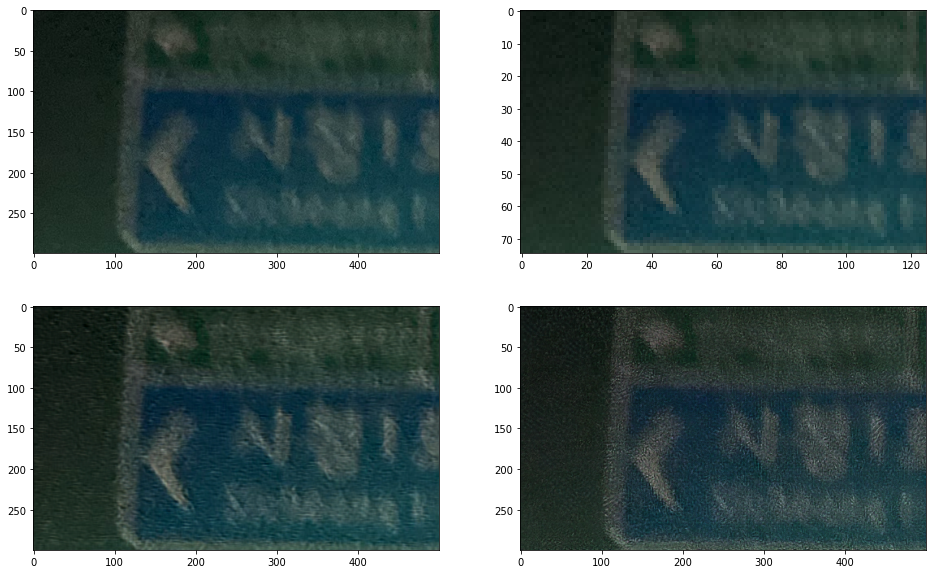

In [68]:
front_view_RGB = cv.cvtColor(front_view,cv.COLOR_BGR2RGB)[600:900,1800:2300]
size_down = cv.resize(front_view_RGB,
                    (125,75))
srcnn_do = apply_srcnn(front_view_RGB)
srgan_do = apply_srgan(size_down)
plt.figure(figsize = (16,10))
plt.subplot(2,2,1)
plt.imshow(front_view_RGB)
plt.subplot(2,2,2)
plt.imshow(size_down)
plt.subplot(2,2,3)
plt.imshow(srcnn_do)
plt.subplot(2,2,4)
plt.imshow(srgan_do)
plt.show()

### 드디어 무언가 수정된 사진이 나왔습니다.. 특별히 나아졌는지는 모르겠군요. 아마 흔들린 사진까지는 어떻게 해줄 수 없는게 아닌지 싶은 생각이 듭니다. 다시 낙엽사진으로 도전해보겠습니다.

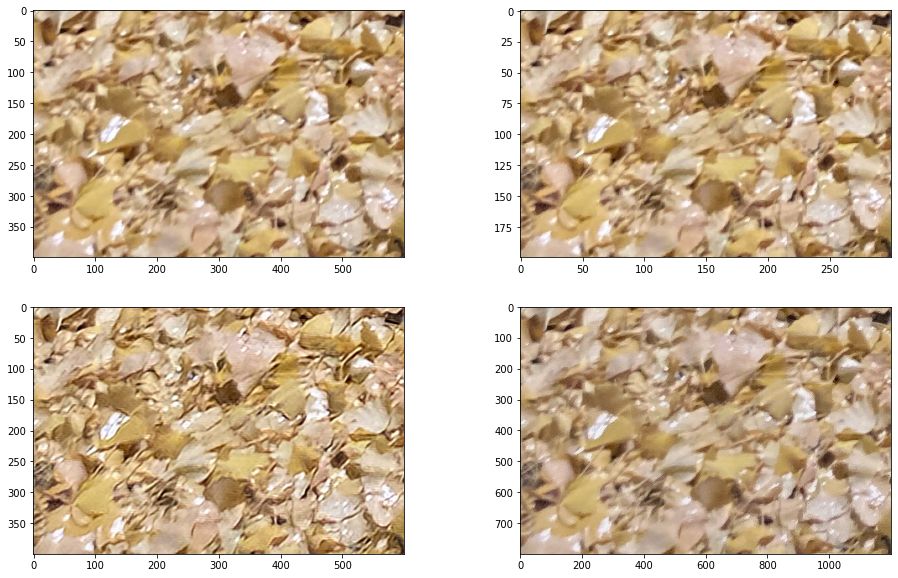

In [73]:
leaves_RGB = cv.cvtColor(leaves,cv.COLOR_BGR2RGB)[3000:3400,500:1100]
size_down = cv.resize(leaves_RGB,
                    (300,200),
                    interpolation=cv.INTER_CUBIC)
srcnn_do = apply_srcnn(leaves_RGB)
srgan_do = apply_srgan(size_down)
plt.figure(figsize = (16,10))
plt.subplot(2,2,1)
plt.imshow(leaves_RGB)
plt.subplot(2,2,2)
plt.imshow(size_down)
plt.subplot(2,2,3)
plt.imshow(srcnn_do)
plt.subplot(2,2,4)
plt.imshow(srgan_do)
plt.show()

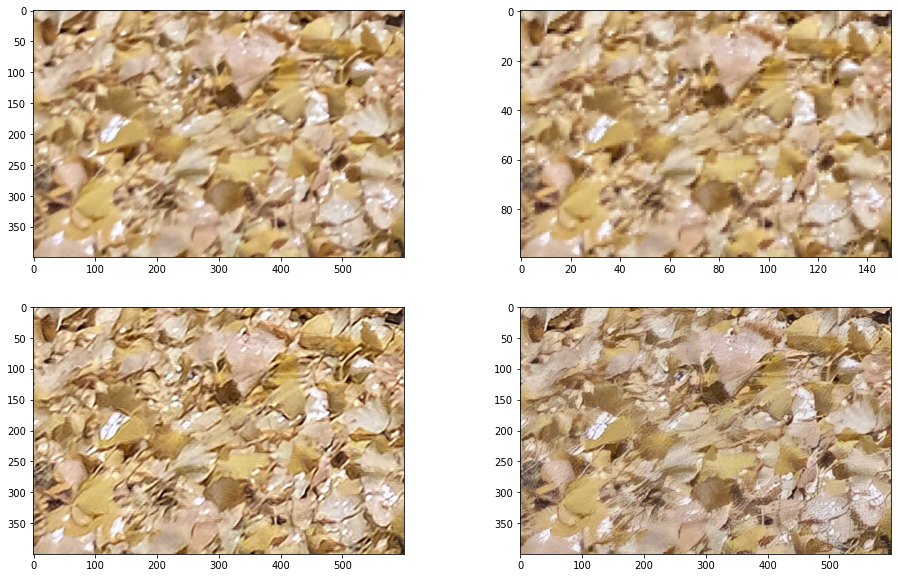

In [74]:
leaves_RGB = cv.cvtColor(leaves,cv.COLOR_BGR2RGB)[3000:3400,500:1100]
size_down = cv.resize(leaves_RGB,
                    (150,100),
                    interpolation=cv.INTER_CUBIC)
srcnn_do = apply_srcnn(leaves_RGB)
srgan_do = apply_srgan(size_down)
plt.figure(figsize = (16,10))
plt.subplot(2,2,1)
plt.imshow(leaves_RGB)
plt.subplot(2,2,2)
plt.imshow(size_down)
plt.subplot(2,2,3)
plt.imshow(srcnn_do)
plt.subplot(2,2,4)
plt.imshow(srgan_do)
plt.show()

### 결론... SRCNN은 경계를 조금 뚜렷하게 해서, 이미지를 처리하고, SRGAN은 열심히 창의력을 더해 이미지를 만듭니다...

In [54]:
type(lr_img),lr_img.shape

(numpy.ndarray, (339, 510, 3))

## 5) gif 영상 품질 업데이트 하기

### 주어진 gif영상을 업데이트 해보겠습니다.

In [7]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
# 다운받은 파일의 경로를 설정해 주세요.
gif = cv.VideoCapture("data/wine_lr.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 13
frame 크기 : (340, 355, 3)


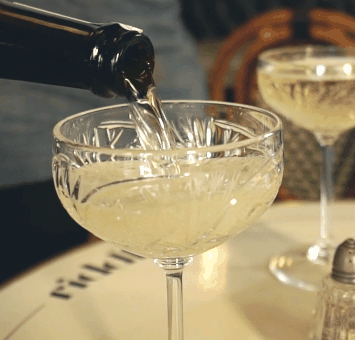

In [2]:
from IPython.display import Image as show_gif

show_gif("data/wine_lr.gif",width=800)

## 노드에서 이렇게 하면, gif 출력이 된다고 했지만, 안해준다...
![이미지](data/wine_lr.gif)

## 그리고 기분탓인지는 몰라도 원본 파일도 조금 이상한 것 같다ㅜㅜㅠ 원본도 조금 수정을 하겠다..

In [8]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]


In [10]:
frames_sr = []
for frame in frames:
    frame_sr = apply_srgan(frame)
    frames_sr.append(frame_sr)

import imageio
imageio.mimsave("data/wine_lr_new.gif", frames)
imageio.mimsave("data/wine_new.gif", frames_sr)

<img src="data/wine_lr_new.gif" width=600 height=600 title="수정전" alt="wine"></img><img src="data/wine_new.gif" width=600 height=600 title="수정후" alt="wine_new"></img>


## 원본 사진이 잘 안움직이다가 움직인다는 것을 제외하면 더 나아진 것이 있는지 확실히는 모르겠습니다;;

# 4. 아쉬운 점

## 1) 중간에 SRGAN 모델을 완벽히 구현하지 못한 것 같아 아쉽습니다. 가능하면 시간을 들여서 시도해봐야겠습니다.

## 2) 정량적 평가방법의 한계가 너무 크게 느껴집니다. 하다못해, 거의 대부분의 결과가 Bicubic Interpolation의 점수가 가장 높습니다... 더 좋게 평가할 방법은 없는 것일까 생각해봐야겠습니다!!
